In [1]:
import pickle
from helper_fxns import convert_param_vec_dict_to_param_dict, gelman_rubin_trace_dict, print_convergence_summary, sample_plots, create_trace_matrix, plot_histograms
from earm.lopez_embedded import model
%matplotlib inline
import os
import numpy as np
from corner import corner
import matplotlib.pyplot as plt
import seaborn as sns

/Users/Erin/Library/Python/2.7/lib/python/site-packages/IPython/html.py:14: ShimWarning: The `IPython.html` package has been deprecated. You should import from `notebook` instead. `IPython.html.widgets` has moved to `ipywidgets`.
  "`IPython.html.widgets` has moved to `ipywidgets`.", ShimWarning)
/Users/Erin/Library/Python/2.7/lib/python/site-packages/IPython/utils/traitlets.py:5: UserWarning: IPython.utils.traitlets has moved to a top-level traitlets package.
  warn("IPython.utils.traitlets has moved to a top-level traitlets package.")


In [2]:
os.chdir('/Users/Erin/git/accre_data_analysis/gamma_levels/')

In [3]:
traces = {}
for trace in ['a', 'b', 'c', 'd']:
    traces[trace] = [np.load('earm_mtdreamzs_3chain_uniform_gammalevels_'+str(trace)+'_sampled_params_chain_0.npy')]
    for chain in range(1, 3):
        traces[trace].append(np.load('earm_mtdreamzs_3chain_uniform_gammalevels_'+str(trace)+'_sampled_params_chain_'+str(chain)+'.npy'))

In [4]:
logps = {}
for trace in ['a']:
    logps[trace] = [np.load('earm_mtdreamzs_3chain_uniform_gammalevels_'+str(trace)+'_logps_chain_0.npy')]
    print 'Logp of trace: ',trace,' chain: 0 = ',logps[trace][-1]
    for chain in range(1, 3):
        logps[trace].append(np.load('earm_mtdreamzs_3chain_uniform_gammalevels_'+str(trace)+'_logps_chain_'+str(chain)+'.npy'))
        print 'Logp of trace: ',trace,' chain: ',chain,' = ',logps[trace][-1][-1]

Logp of trace:  a  chain: 0 =  [[ 105.95561143]
 [ 105.95561143]
 [ 105.95561143]
 ..., 
 [ 105.24697817]
 [ 105.24697817]
 [ 105.24697817]]
Logp of trace:  a  chain:  1  =  [ 105.84381497]
Logp of trace:  a  chain:  2  =  [ 107.55629472]


In [5]:
traces['a'][0][:,72]

array([ 6.1763924 ,  6.1763924 ,  6.1763924 , ...,  8.69854358,
        8.69854358,  8.69854358])

In [7]:
param_trace_dicts = {}
param_trace_dict_a = {}
gelman_rubin_dicts = {}
param_trace_dict_a['param_list'] = [param.name for param in model.parameters_rules()]
for run in ['a', 'b', 'c', 'd']:
    for i, param in enumerate(model.parameters_rules()):
        param_trace_dict_a[param.name] = [traces[run][chain][:,i] for chain in range(len(traces[run]))]
    param_trace_dicts[run] = param_trace_dict_a
    gelman_rubin_dicts[run] = gelman_rubin_trace_dict(param_trace_dict_a)
    param_trace_dict_a = {}
    param_trace_dict_a['param_list'] = [param.name for param in model.parameters_rules()]

In [8]:
print_convergence_summary(param_trace_dicts['a'])

Number of parameters with GR below 1.2:  101  of  105  parameters.
Percent of parameters with GR below 1.2:  96.1904761905
Number of parameters with GR below 1.1:  77  of  105  parameters.
Percent of parameters with GR below 1.1:  73.3333333333


[101, 96.19047619047619, 77, 73.33333333333333]

In [9]:
print_convergence_summary(param_trace_dicts['b'])

Number of parameters with GR below 1.2:  79  of  105  parameters.
Percent of parameters with GR below 1.2:  75.2380952381
Number of parameters with GR below 1.1:  55  of  105  parameters.
Percent of parameters with GR below 1.1:  52.380952381


[79, 75.23809523809524, 55, 52.38095238095239]

In [10]:
print_convergence_summary(param_trace_dicts['c'])

Number of parameters with GR below 1.2:  105  of  105  parameters.
Percent of parameters with GR below 1.2:  100.0
Number of parameters with GR below 1.1:  96  of  105  parameters.
Percent of parameters with GR below 1.1:  91.4285714286


[105, 100.0, 96, 91.42857142857143]

In [11]:
print_convergence_summary(param_trace_dicts['d'])

Number of parameters with GR below 1.2:  99  of  105  parameters.
Percent of parameters with GR below 1.2:  94.2857142857
Number of parameters with GR below 1.1:  83  of  105  parameters.
Percent of parameters with GR below 1.1:  79.0476190476


[99, 94.28571428571428, 83, 79.04761904761905]

50000
3
50000


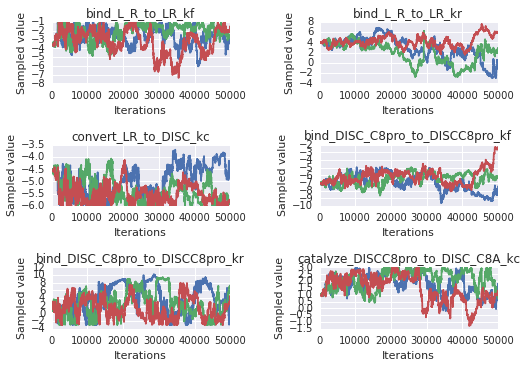

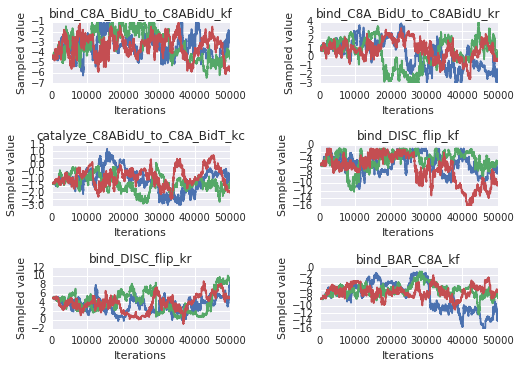

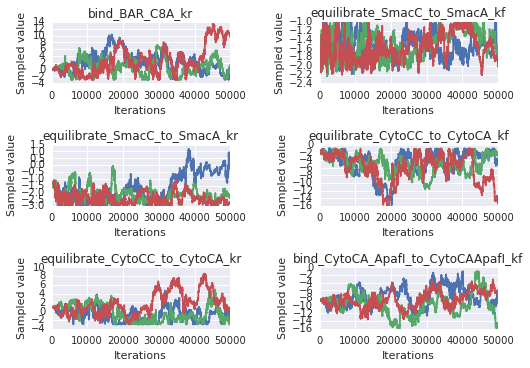

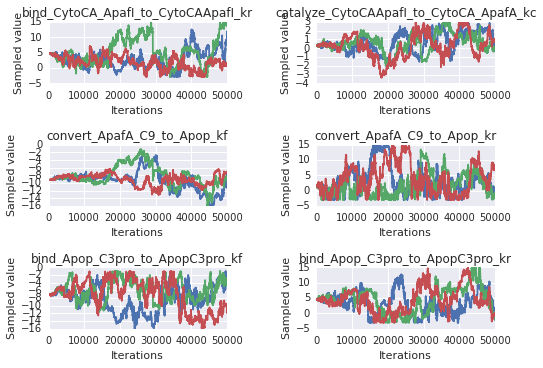

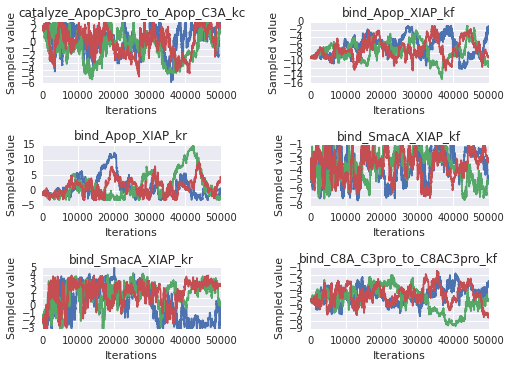

...

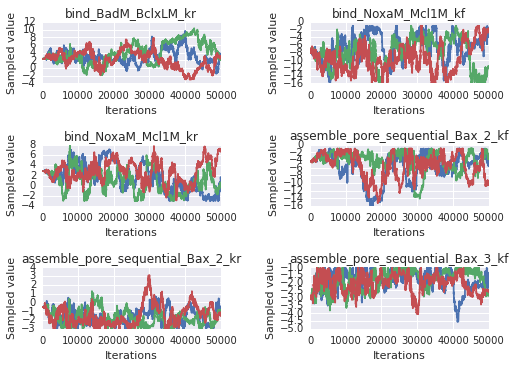

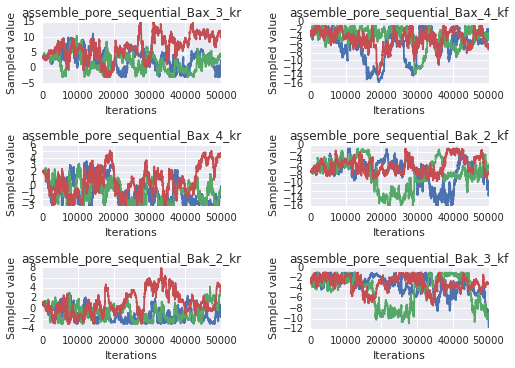

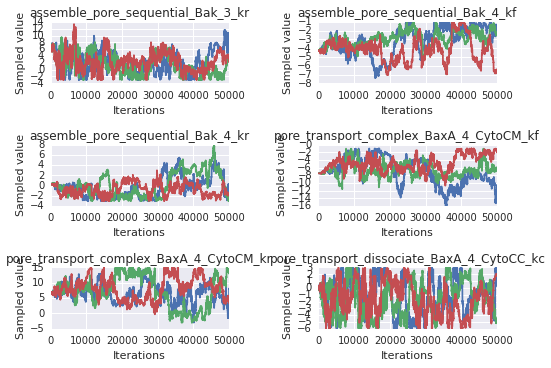

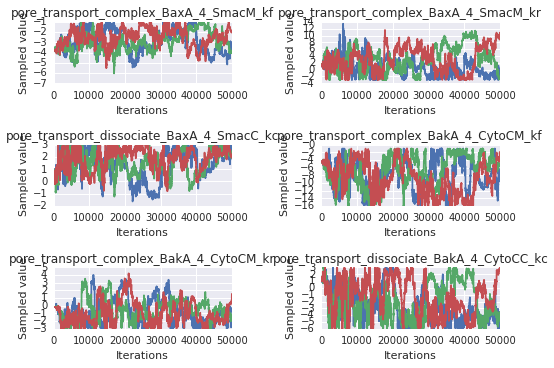

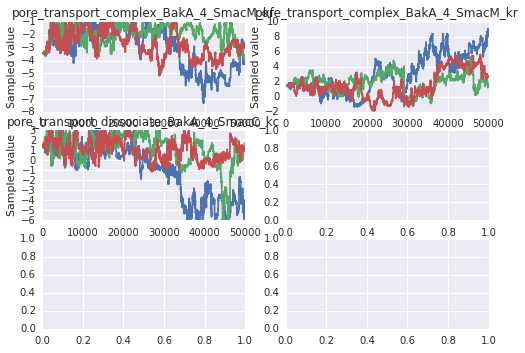

In [12]:
sample_plots(param_trace_dicts['a'])

50000
3
50000


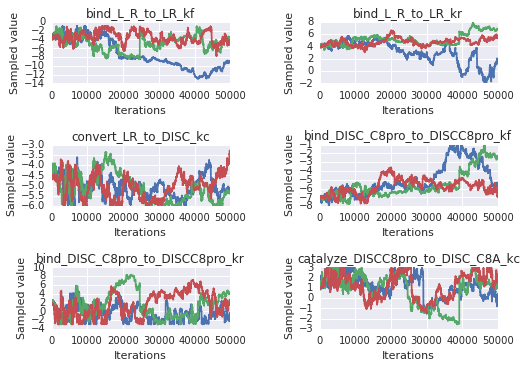

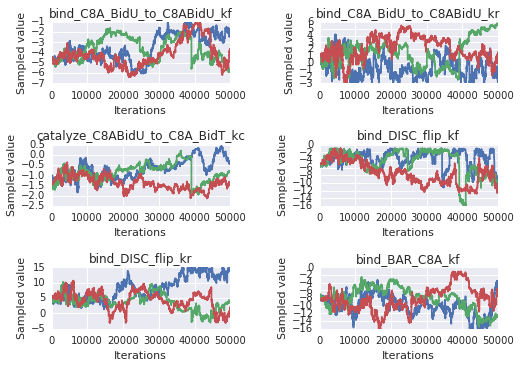

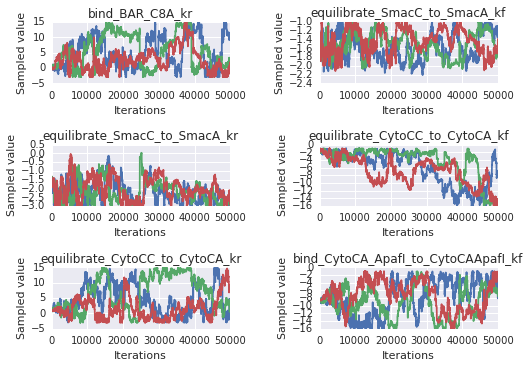

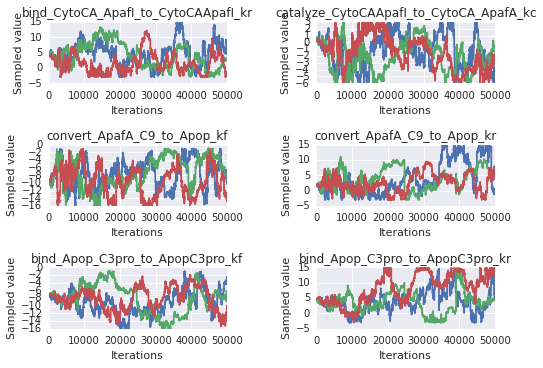

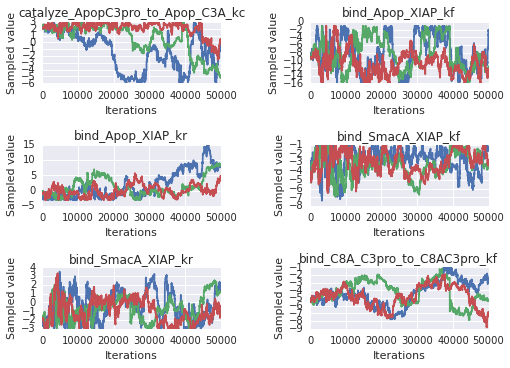

...

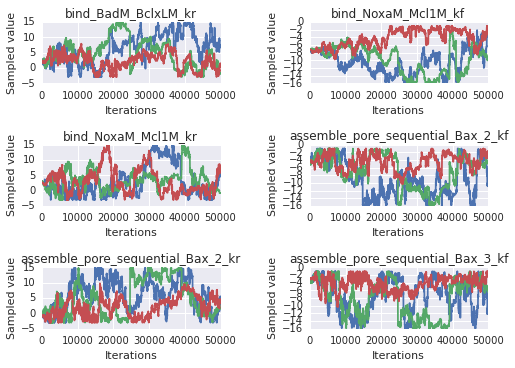

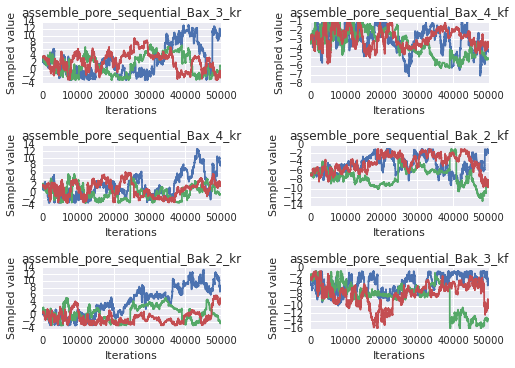

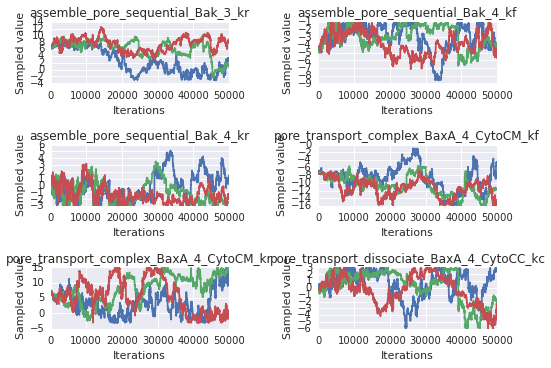

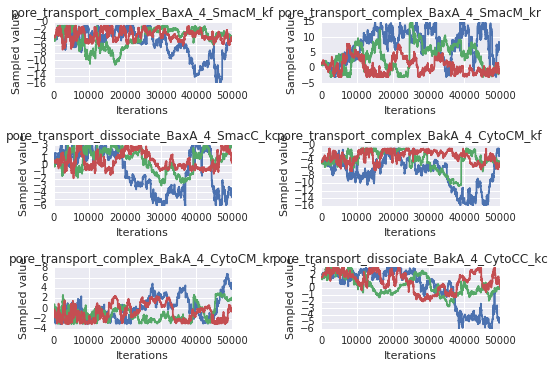

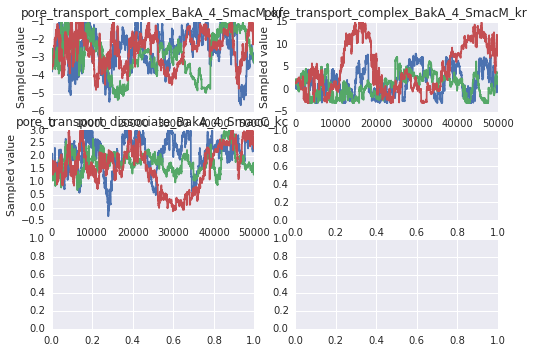

In [13]:
sample_plots(param_trace_dicts['b'])

50000
3
50000


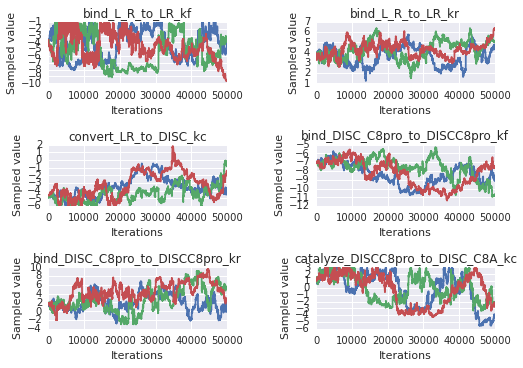

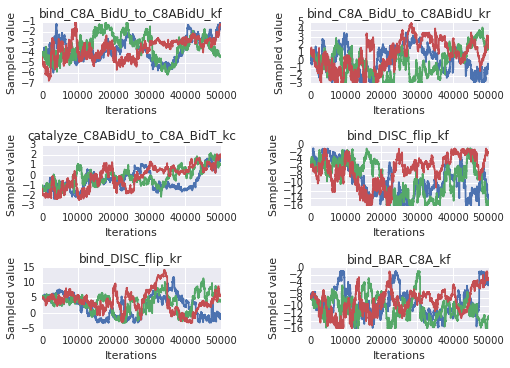

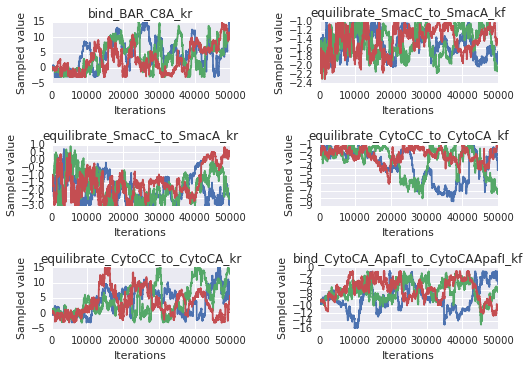

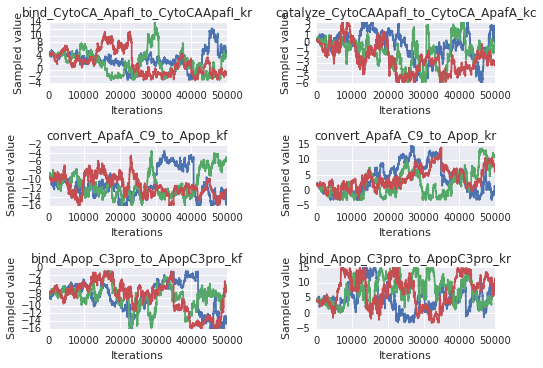

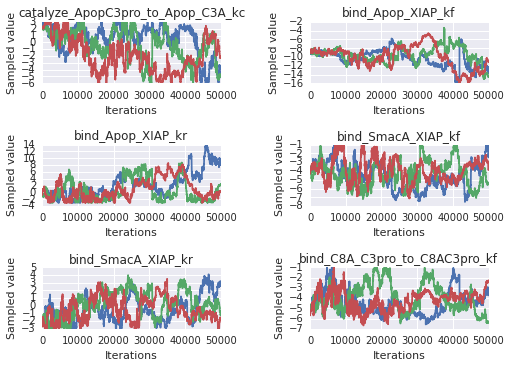

...

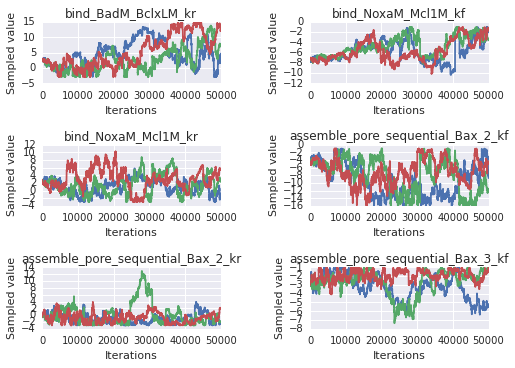

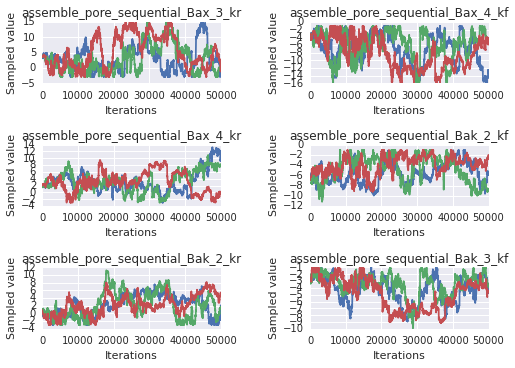

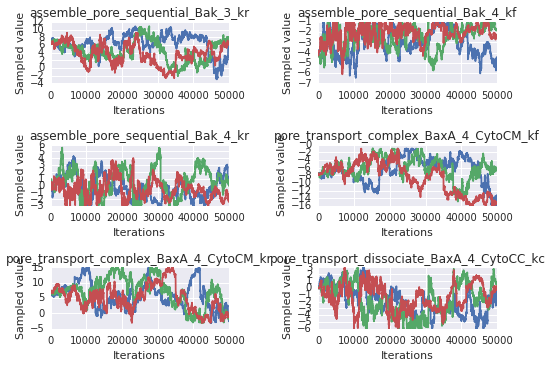

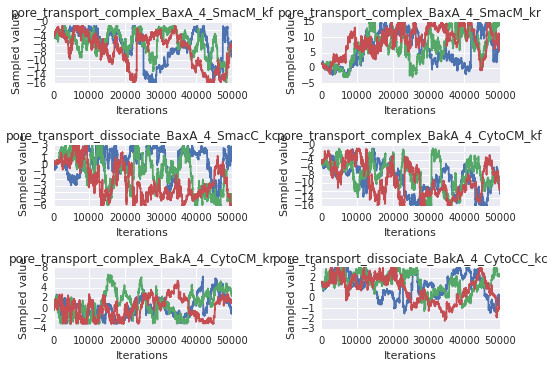

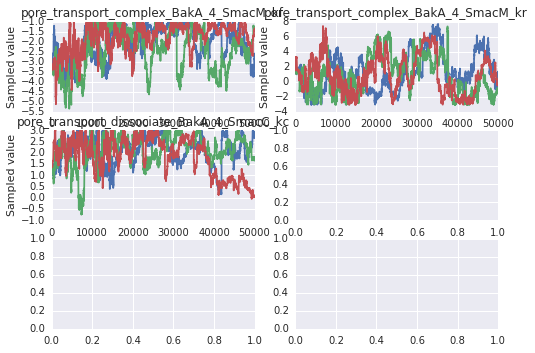

In [14]:
sample_plots(param_trace_dicts['c'])

In [15]:
trace_arr_a = create_trace_matrix(param_trace_dicts['a'], burnin=25000, thin=1)
trace_arr_b = create_trace_matrix(param_trace_dicts['b'], burnin=25000, thin=1)
trace_arr_c = create_trace_matrix(param_trace_dicts['c'], burnin=25000, thin=1)
trace_arr_d = create_trace_matrix(param_trace_dicts['d'], burnin=25000, thin=1)

In [17]:
trace_arr_a_short = create_trace_matrix(param_trace_dicts['a'], burnin=40000, thin=1)
trace_arr_b_short = create_trace_matrix(param_trace_dicts['b'], burnin=40000, thin=1)
trace_arr_c_short = create_trace_matrix(param_trace_dicts['c'], burnin=40000, thin=1)
trace_arr_d_short = create_trace_matrix(param_trace_dicts['d'], burnin=40000, thin=1)

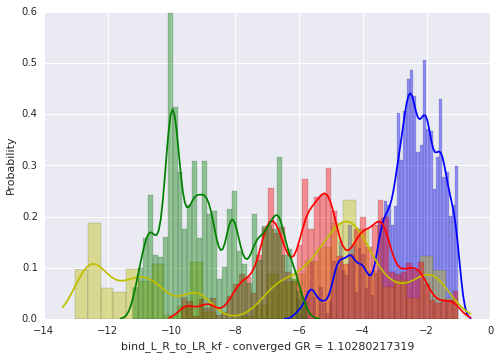

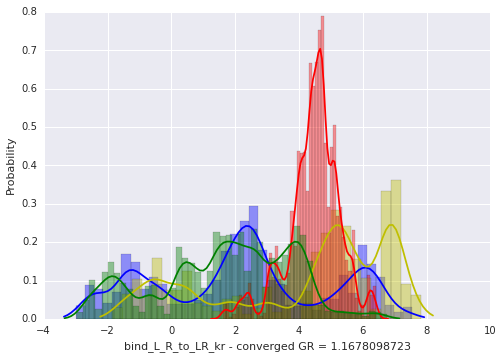

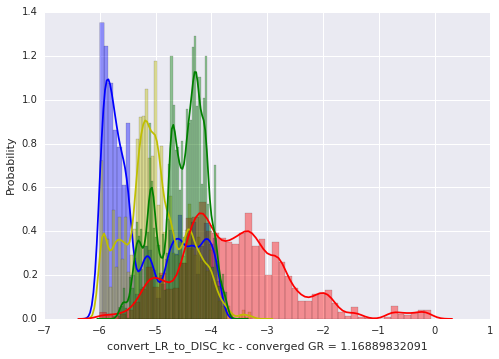

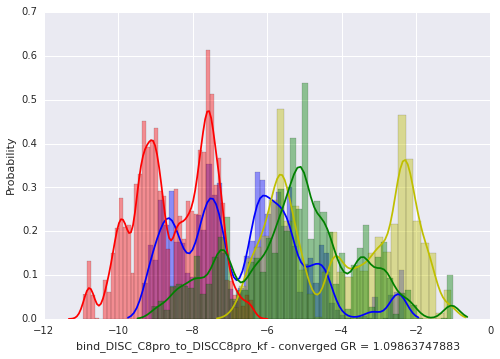

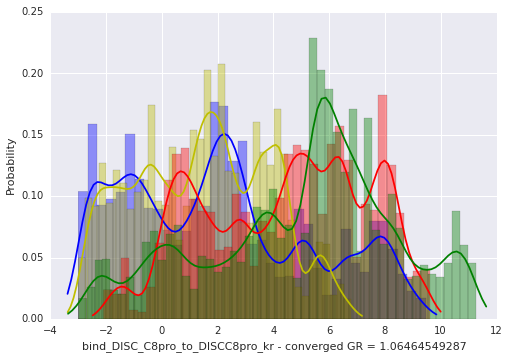

...

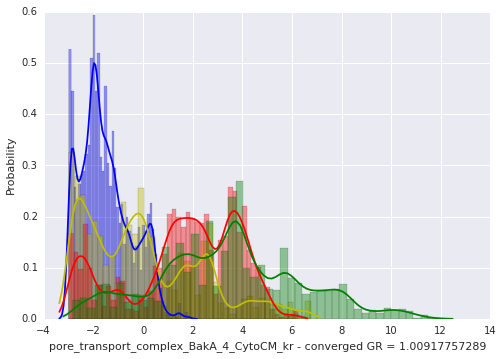

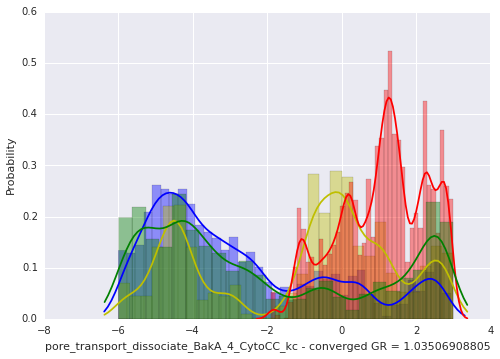

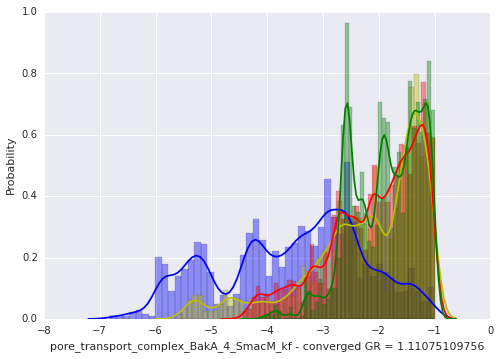

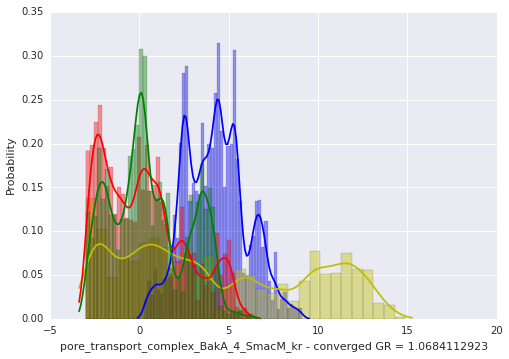

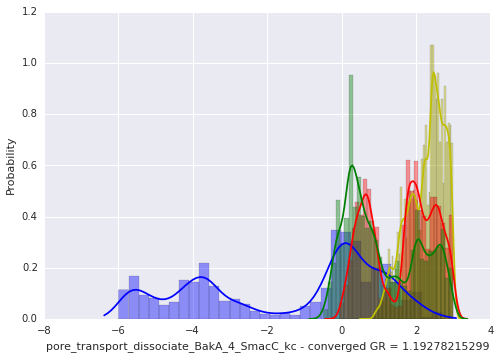

In [18]:
for dim, param_name in enumerate([param.name for param in model.parameters_rules()]):
    fig = plt.figure()
    sns.plotting_context('notebook')
    ax = sns.distplot(trace_arr_a_short[:,dim], hist=True, color='b')
    sns.distplot(trace_arr_b_short[:,dim], hist=True, color='y')
    sns.distplot(trace_arr_c_short[:,dim], hist=True, color='r')
    sns.distplot(trace_arr_d_short[:,dim], hist=True, color='g')
    if gelman_rubin_dicts['a'][param_name] < 1.2:
        sns.axlabel(param_name+' - converged GR = '+str(gelman_rubin_dicts['a'][param_name]), 'Probability')
    else:
        sns.axlabel(param_name+' - not converged GR = '+str(gelman_rubin_dicts['a'][param_name]), 'Probability')

/System/Library/Frameworks/Python.framework/Versions/2.7/Extras/lib/python/matplotlib/pyplot.py:412: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_num_figures`).
  max_open_warning, RuntimeWarning)


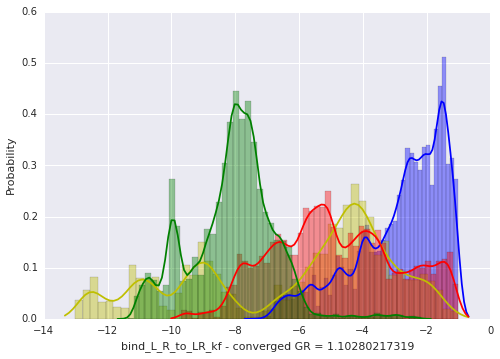

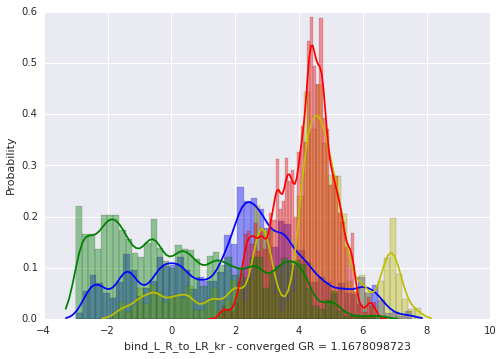

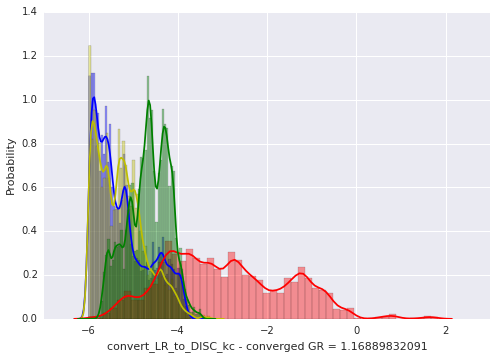

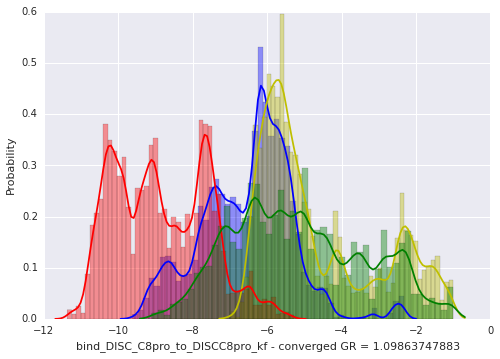

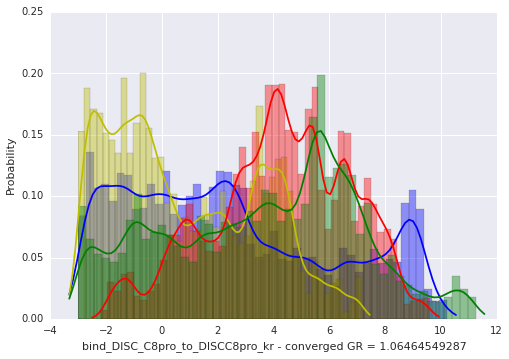

...

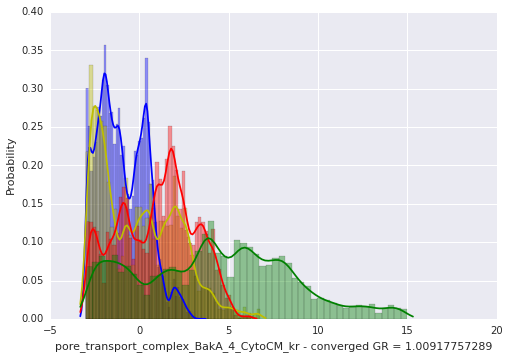

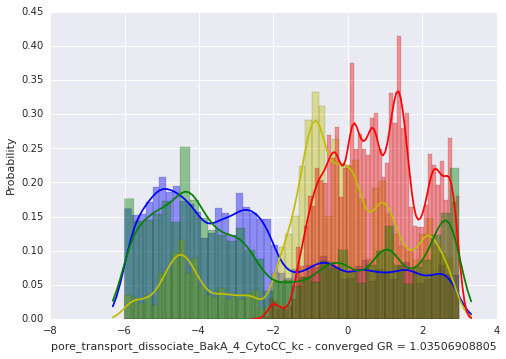

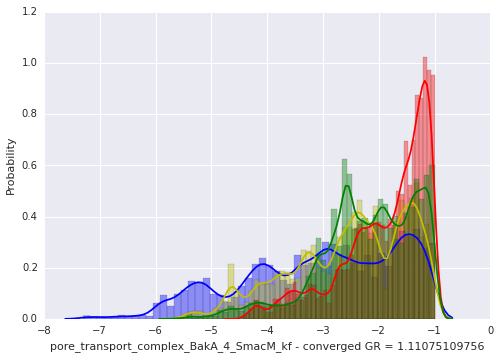

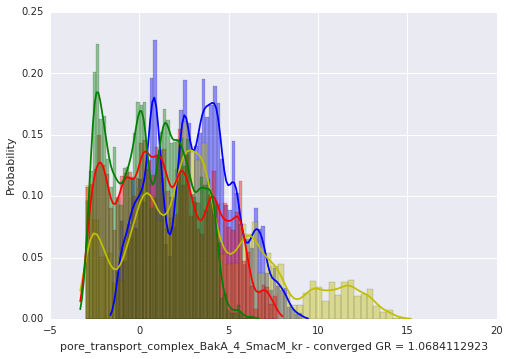

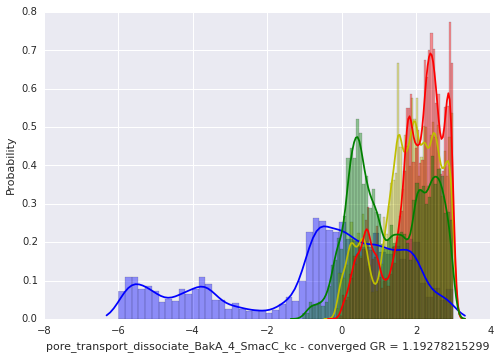

In [16]:
for dim, param_name in enumerate([param.name for param in model.parameters_rules()]):
    fig = plt.figure()
    sns.plotting_context('notebook')
    ax = sns.distplot(trace_arr_a[:,dim], hist=True, color='b')
    sns.distplot(trace_arr_b[:,dim], hist=True, color='y')
    sns.distplot(trace_arr_c[:,dim], hist=True, color='r')
    sns.distplot(trace_arr_d[:,dim], hist=True, color='g')
    if gelman_rubin_dicts['a'][param_name] < 1.2:
        sns.axlabel(param_name+' - converged GR = '+str(gelman_rubin_dicts['a'][param_name]), 'Probability')
    else:
        sns.axlabel(param_name+' - not converged GR = '+str(gelman_rubin_dicts['a'][param_name]), 'Probability')

In [19]:
traces['a'][1][:,0]

array([-3.6312253 , -3.6312253 , -3.6312253 , ..., -2.65881806,
       -2.65881806, -2.65881806])

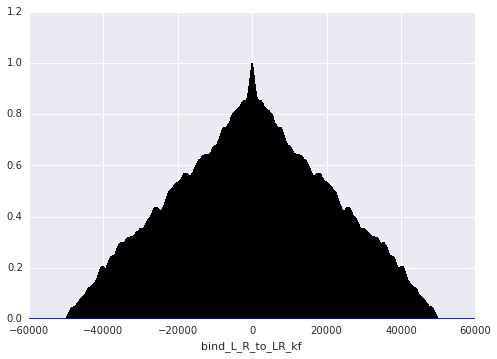

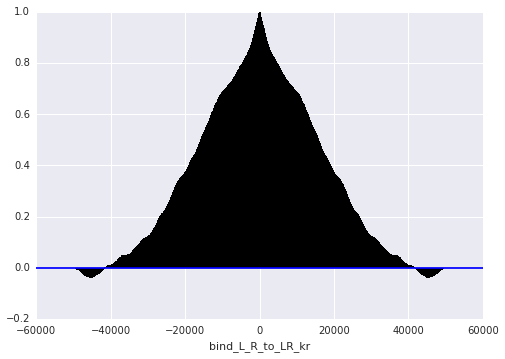

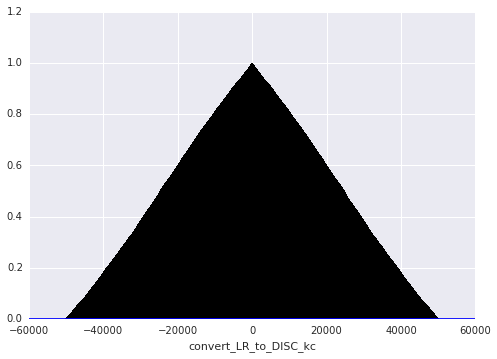

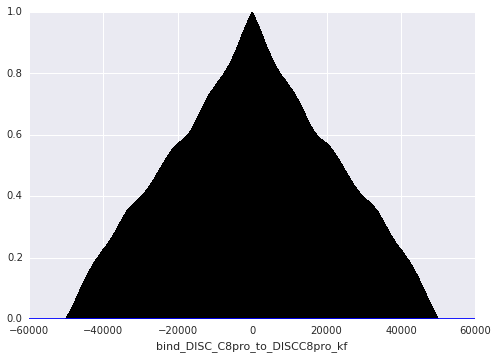

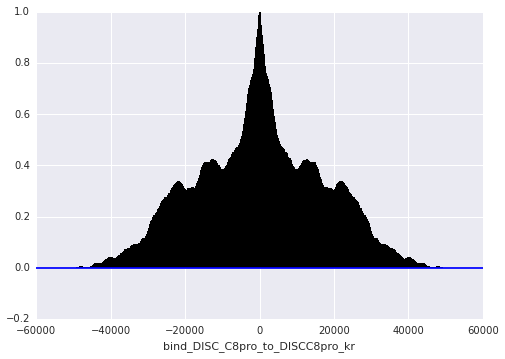

...

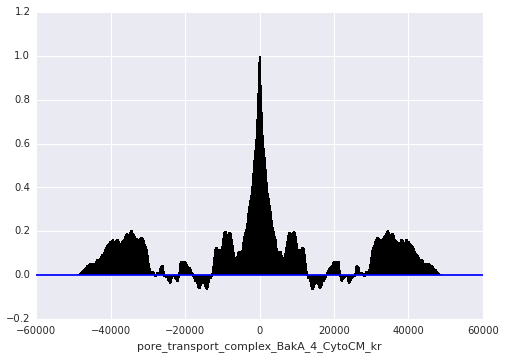

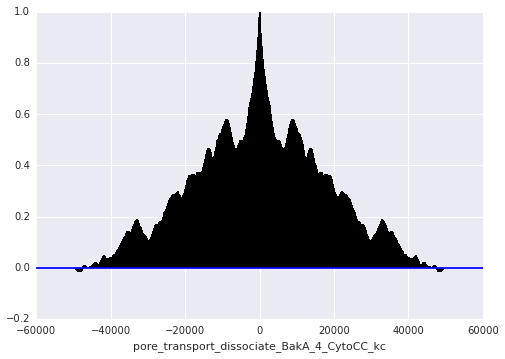

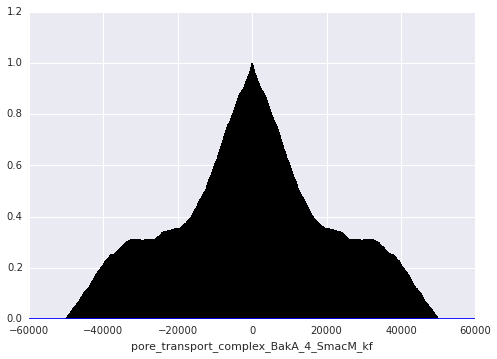

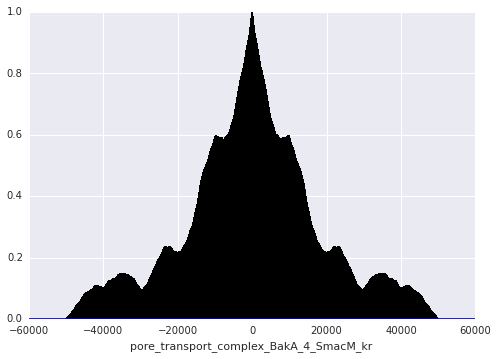

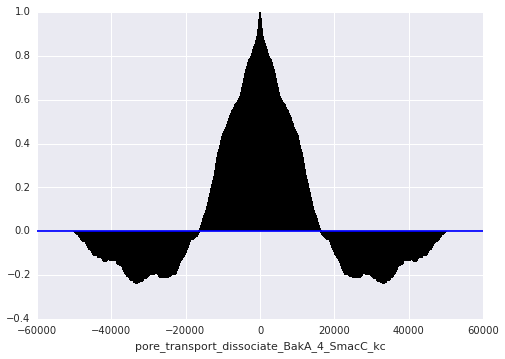

In [37]:
for dim, param_name in enumerate([param.name for param in model.parameters_rules()]):
    fig = plt.figure()
    plt.acorr(traces['a'][0][:,dim], maxlags=None)
    plt.xlabel(str(param_name))

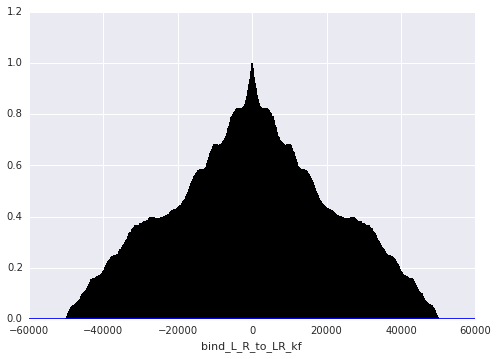

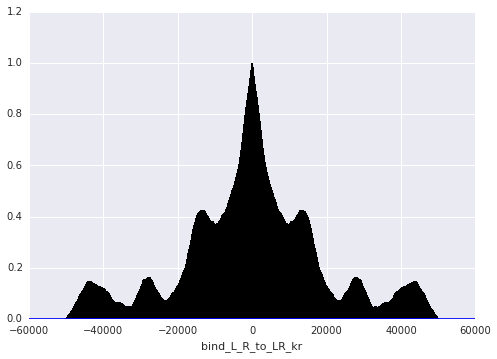

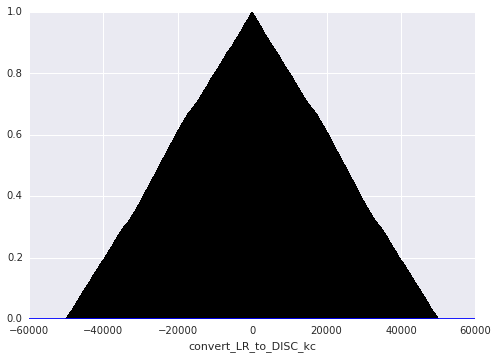

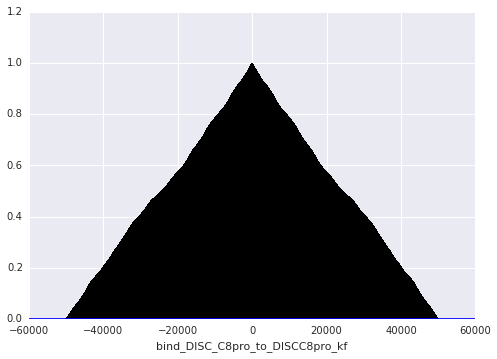

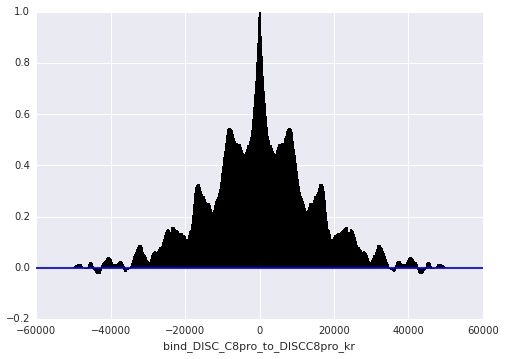

...

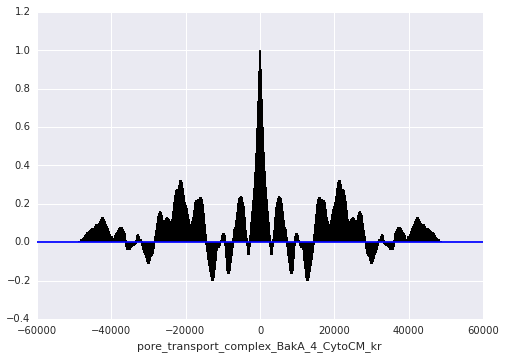

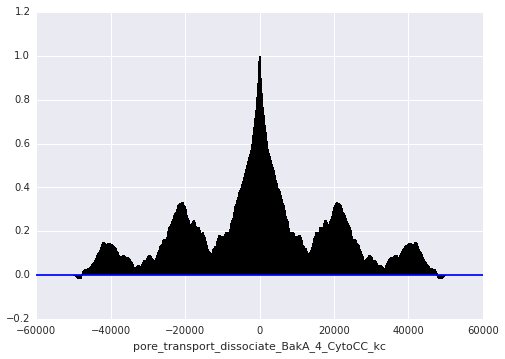

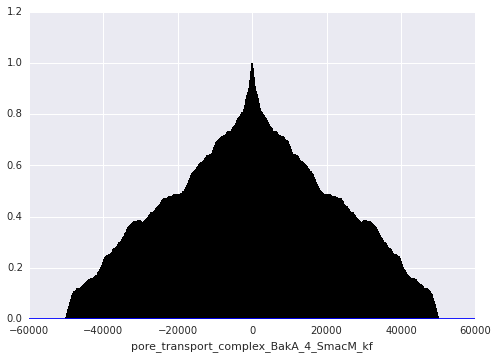

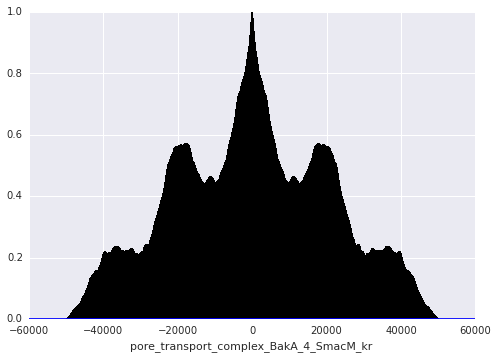

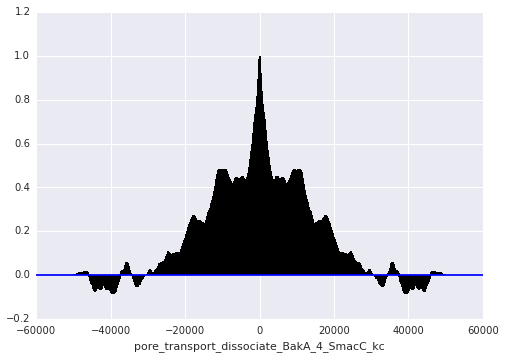

In [38]:
for dim, param_name in enumerate([param.name for param in model.parameters_rules()]):
    fig = plt.figure()
    plt.acorr(traces['a'][1][:,dim], maxlags=None)
    plt.xlabel(str(param_name))

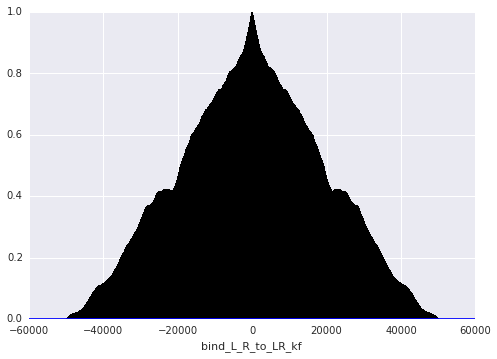

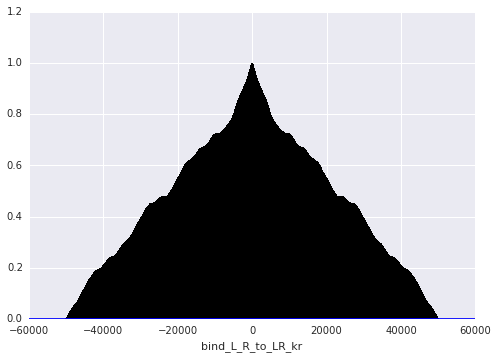

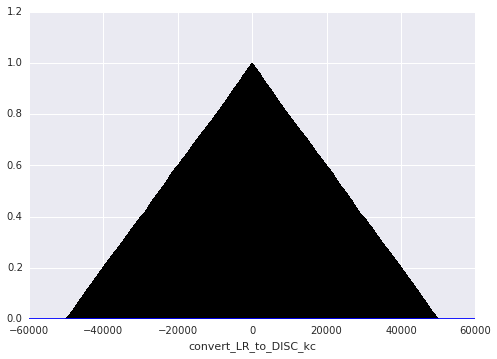

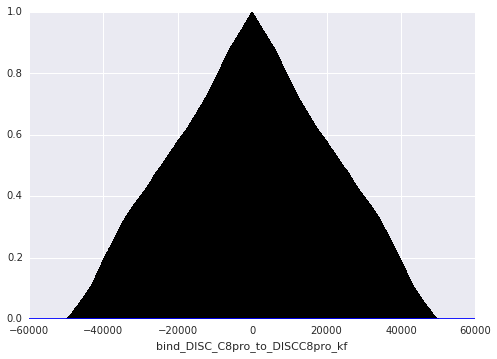

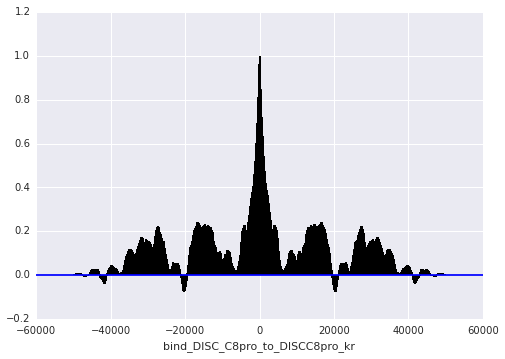

...

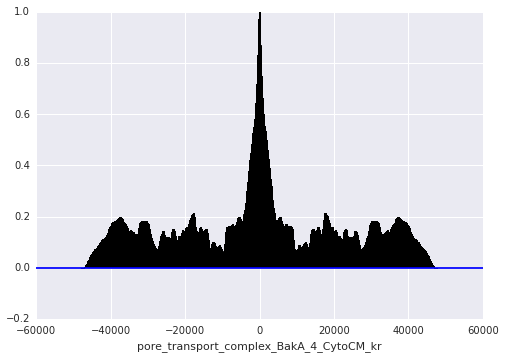

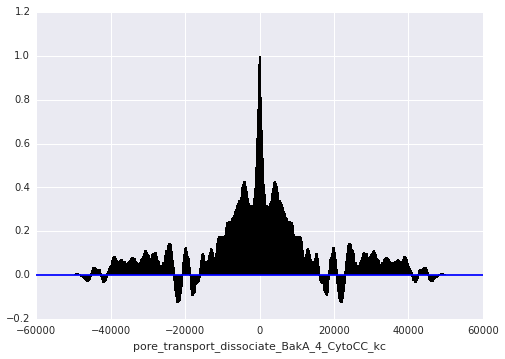

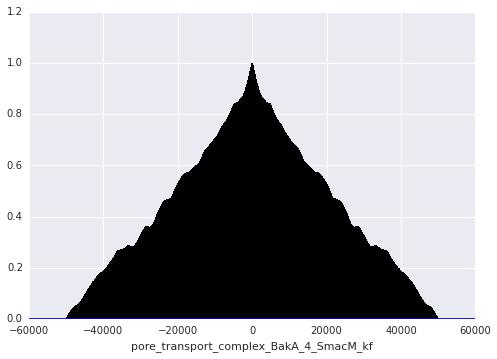

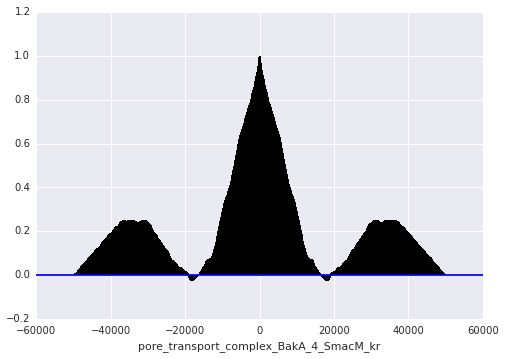

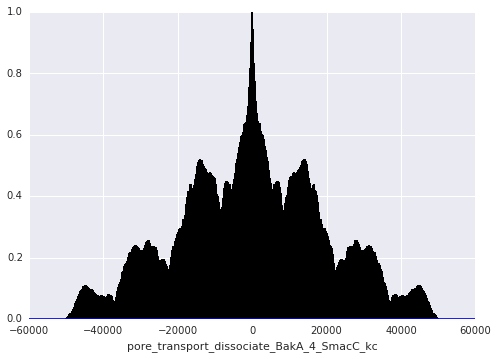

In [39]:
for dim, param_name in enumerate([param.name for param in model.parameters_rules()]):
    fig = plt.figure()
    plt.acorr(traces['a'][2][:,dim], maxlags=None)
    plt.xlabel(str(param_name))

In [ ]:
corner(trace_arr_a[:,50:60:], labels=param_trace_dict_a['param_list'][50:60], bins=10)

In [21]:
acceptance_rates = np.zeros((len(traces['a'][0][0],)))
vector_acceptance_rate = 0
running_acceptance_rates = np.zeros((len(traces['a'][0][0]), len(traces['a'][0])))
running_acceptance_rates_100window = np.zeros((len(traces['a'][0][0]), 500))
n_vector_acceptances = 0
n_100windowvec_acceptances = 0
running_acceptance_rates_vec = np.zeros((1, len(traces['a'][0])))
running_acceptances_rates_vec_100window = np.zeros((1, 500))
for dim in range(len(traces['a'][0][0])):
    n_100window_acceptances = 0
    n_acceptances = 0
    
    for iteration in range(1, len(traces['a'][0])):
        if dim == 0:
            comparison = traces['a'][0][iteration] == traces['a'][0][iteration-1]
            if not np.all(comparison):
                n_vector_acceptances += 1
                n_100windowvec_acceptances += 1
            running_acceptance_rates_vec[0, iteration] = float(n_vector_acceptances)/iteration
            if iteration % 100 == 0:
                running_acceptances_rates_vec_100window[0, iteration/100] = float(n_100windowvec_acceptances)/100
                n_100windowvec_acceptances = 0
        if traces['a'][0][iteration][dim] != traces['a'][0][iteration-1][dim]:
            n_acceptances += 1
            n_100window_acceptances += 1
        running_acceptance_rates[dim, iteration] = float(n_acceptances)/iteration
        
        if iteration % 100 == 0:
            running_acceptance_rates_100window[dim, iteration/100] = float(n_100window_acceptances)/100
            n_100window_acceptances = 0
            
    acceptance_rates[dim] = float(n_acceptances)/len(traces['a'][0])
    print 'N acceptances for parameter: ',str(param_trace_dict_a['param_list'][dim]),' = ',str(n_acceptances),' acceptance rate: ',str(acceptance_rates[dim])
    n_acceptances = 0
print 'n vector acceptances: ',n_vector_acceptances
print 'Acceptance rate for vector: ',float(n_vector_acceptances)/len(traces['a'][0])
running_acceptance_rates
running_acceptance_rates_100window
running_acceptance_rates_vec
running_acceptances_rates_vec_100window

N acceptances for parameter:  bind_L_R_to_LR_kf  =  9470  acceptance rate:  0.1894
N acceptances for parameter:  bind_L_R_to_LR_kr  =  9496  acceptance rate:  0.18992
N acceptances for parameter:  convert_LR_to_DISC_kc  =  9497  acceptance rate:  0.18994
N acceptances for parameter:  bind_DISC_C8pro_to_DISCC8pro_kf  =  9487  acceptance rate:  0.18974
N acceptances for parameter:  bind_DISC_C8pro_to_DISCC8pro_kr  =  9401  acceptance rate:  0.18802
N acceptances for parameter:  catalyze_DISCC8pro_to_DISC_C8A_kc  =  9432  acceptance rate:  0.18864
N acceptances for parameter:  bind_C8A_BidU_to_C8ABidU_kf  =  9476  acceptance rate:  0.18952
N acceptances for parameter:  bind_C8A_BidU_to_C8ABidU_kr  =  9484  acceptance rate:  0.18968
N acceptances for parameter:  catalyze_C8ABidU_to_C8A_BidT_kc  =  9474  acceptance rate:  0.18948
N acceptances for parameter:  bind_DISC_flip_kf  =  9483  acceptance rate:  0.18966
N acceptances for parameter:  bind_DISC_flip_kr  =  9423  acceptance rate:  0.1

array([[ 0.  ,  0.1 ,  0.23,  0.41,  0.45,  0.5 ,  0.5 ,  0.55,  0.45,
         0.6 ,  0.7 ,  0.48,  0.56,  0.53,  0.54,  0.52,  0.52,  0.56,
         0.51,  0.62,  0.59,  0.55,  0.53,  0.53,  0.5 ,  0.48,  0.46,
         0.51,  0.37,  0.39,  0.26,  0.18,  0.32,  0.42,  0.39,  0.4 ,
         0.43,  0.49,  0.45,  0.41,  0.22,  0.36,  0.3 ,  0.25,  0.27,
         0.32,  0.39,  0.35,  0.4 ,  0.47,  0.41,  0.31,  0.34,  0.42,
         0.37,  0.37,  0.33,  0.3 ,  0.44,  0.41,  0.5 ,  0.5 ,  0.44,
         0.45,  0.29,  0.37,  0.33,  0.2 ,  0.18,  0.17,  0.23,  0.4 ,
         0.35,  0.38,  0.28,  0.38,  0.26,  0.4 ,  0.33,  0.39,  0.29,
         0.39,  0.37,  0.36,  0.29,  0.26,  0.32,  0.31,  0.34,  0.33,
         0.35,  0.32,  0.2 ,  0.24,  0.37,  0.21,  0.24,  0.23,  0.24,
         0.25,  0.22,  0.2 ,  0.17,  0.23,  0.29,  0.18,  0.16,  0.13,
         0.12,  0.18,  0.12,  0.13,  0.13,  0.24,  0.18,  0.27,  0.41,
         0.34,  0.37,  0.37,  0.37,  0.3 ,  0.23,  0.26,  0.38,  0.24,
      

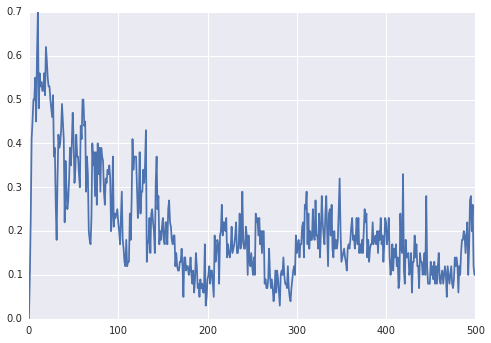

In [22]:
plt.plot(range(500), running_acceptances_rates_vec_100window[0,:])

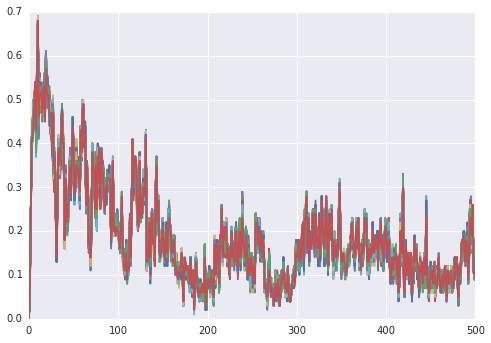

In [23]:
for dim in range(105):
    plt.plot(range(500), running_acceptance_rates_100window[dim, :])

In [24]:
acceptance_rates = np.zeros((len(traces['a'][1][0],)))
running_acceptance_rates = np.zeros((len(traces['a'][1][0]), len(traces['a'][1])))
running_acceptance_rates_100window = np.zeros((len(traces['a'][1][0]), 500))
for dim in range(len(traces['a'][1][0])):
    n_100window_acceptances = 0
    n_acceptances = 0
    
    for iteration in range(1, len(traces['a'][1])):
        if traces['a'][1][iteration][dim] != traces['a'][1][iteration-1][dim]:
            n_acceptances += 1
            n_100window_acceptances += 1
        running_acceptance_rates[dim, iteration] = float(n_acceptances)/iteration
        if iteration % 100 == 0:
            running_acceptance_rates_100window[dim, iteration/100] = float(n_100window_acceptances)/100
            n_100window_acceptances = 0
    acceptance_rates[dim] = float(n_acceptances)/len(traces['a'][1])
    print 'N acceptances for parameter: ',str(param_trace_dict_a['param_list'][dim]),' = ',str(n_acceptances),' acceptance rate: ',str(acceptance_rates[dim])
    n_acceptances = 0
running_acceptance_rates
running_acceptance_rates_100window

N acceptances for parameter:  bind_L_R_to_LR_kf  =  8757  acceptance rate:  0.17514
N acceptances for parameter:  bind_L_R_to_LR_kr  =  8774  acceptance rate:  0.17548
N acceptances for parameter:  convert_LR_to_DISC_kc  =  8822  acceptance rate:  0.17644
N acceptances for parameter:  bind_DISC_C8pro_to_DISCC8pro_kf  =  8768  acceptance rate:  0.17536
N acceptances for parameter:  bind_DISC_C8pro_to_DISCC8pro_kr  =  8718  acceptance rate:  0.17436
N acceptances for parameter:  catalyze_DISCC8pro_to_DISC_C8A_kc  =  8764  acceptance rate:  0.17528
N acceptances for parameter:  bind_C8A_BidU_to_C8ABidU_kf  =  8775  acceptance rate:  0.1755
N acceptances for parameter:  bind_C8A_BidU_to_C8ABidU_kr  =  8747  acceptance rate:  0.17494
N acceptances for parameter:  catalyze_C8ABidU_to_C8A_BidT_kc  =  8748  acceptance rate:  0.17496
N acceptances for parameter:  bind_DISC_flip_kf  =  8788  acceptance rate:  0.17576
N acceptances for parameter:  bind_DISC_flip_kr  =  8800  acceptance rate:  0.1

array([[ 0.  ,  0.02,  0.26, ...,  0.09,  0.15,  0.1 ],
       [ 0.  ,  0.02,  0.26, ...,  0.09,  0.16,  0.09],
       [ 0.  ,  0.01,  0.26, ...,  0.09,  0.16,  0.1 ],
       ..., 
       [ 0.  ,  0.01,  0.26, ...,  0.1 ,  0.15,  0.1 ],
       [ 0.  ,  0.01,  0.26, ...,  0.1 ,  0.15,  0.1 ],
       [ 0.  ,  0.01,  0.26, ...,  0.09,  0.14,  0.09]])

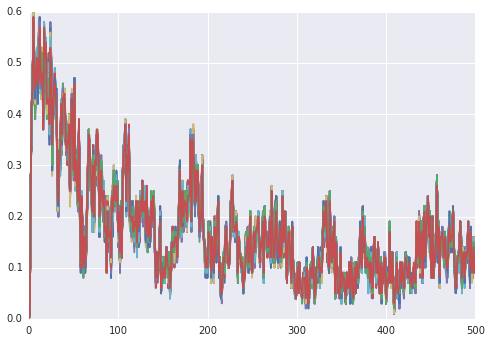

In [26]:
for dim in range(105):
    plt.plot(range(500), running_acceptance_rates_100window[dim, :])

In [27]:
acceptance_rates = np.zeros((len(traces['a'][2][0],)))
running_acceptance_rates = np.zeros((len(traces['a'][2][0]), len(traces['a'][2])))
running_acceptance_rates_100window = np.zeros((len(traces['a'][2][0]), 500))
for dim in range(len(traces['a'][2][0])):
    n_100window_acceptances = 0
    n_acceptances = 0
    
    for iteration in range(1, len(traces['a'][2])):
        if traces['a'][2][iteration][dim] != traces['a'][2][iteration-1][dim]:
            n_acceptances += 1
            n_100window_acceptances += 1
        running_acceptance_rates[dim, iteration] = float(n_acceptances)/iteration
        if iteration % 100 == 0:
            running_acceptance_rates_100window[dim, iteration/100] = float(n_100window_acceptances)/100
            n_100window_acceptances = 0
    acceptance_rates[dim] = float(n_acceptances)/len(traces['a'][2])
    print 'N acceptances for parameter: ',str(param_trace_dict_a['param_list'][dim]),' = ',str(n_acceptances),' acceptance rate: ',str(acceptance_rates[dim])
    n_acceptances = 0
running_acceptance_rates
running_acceptance_rates_100window

N acceptances for parameter:  bind_L_R_to_LR_kf  =  9137  acceptance rate:  0.18274
N acceptances for parameter:  bind_L_R_to_LR_kr  =  9171  acceptance rate:  0.18342
N acceptances for parameter:  convert_LR_to_DISC_kc  =  9150  acceptance rate:  0.183
N acceptances for parameter:  bind_DISC_C8pro_to_DISCC8pro_kf  =  9168  acceptance rate:  0.18336
N acceptances for parameter:  bind_DISC_C8pro_to_DISCC8pro_kr  =  9166  acceptance rate:  0.18332
N acceptances for parameter:  catalyze_DISCC8pro_to_DISC_C8A_kc  =  9190  acceptance rate:  0.1838
N acceptances for parameter:  bind_C8A_BidU_to_C8ABidU_kf  =  9182  acceptance rate:  0.18364
N acceptances for parameter:  bind_C8A_BidU_to_C8ABidU_kr  =  9145  acceptance rate:  0.1829
N acceptances for parameter:  catalyze_C8ABidU_to_C8A_BidT_kc  =  9165  acceptance rate:  0.1833
N acceptances for parameter:  bind_DISC_flip_kf  =  9154  acceptance rate:  0.18308
N acceptances for parameter:  bind_DISC_flip_kr  =  9143  acceptance rate:  0.18286

array([[ 0.  ,  0.06,  0.27, ...,  0.04,  0.07,  0.1 ],
       [ 0.  ,  0.07,  0.27, ...,  0.02,  0.07,  0.09],
       [ 0.  ,  0.07,  0.26, ...,  0.03,  0.07,  0.08],
       ..., 
       [ 0.  ,  0.06,  0.27, ...,  0.03,  0.07,  0.1 ],
       [ 0.  ,  0.06,  0.27, ...,  0.03,  0.07,  0.09],
       [ 0.  ,  0.09,  0.26, ...,  0.04,  0.07,  0.09]])

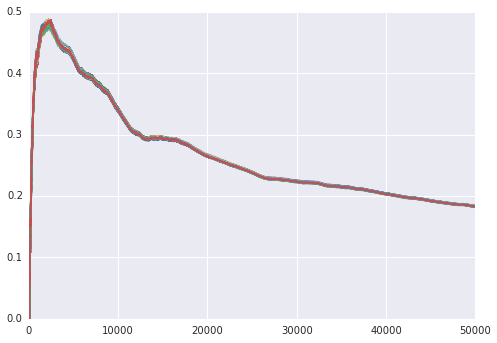

In [28]:
for dim in range(105):
    plt.plot(range(50000), running_acceptance_rates[dim,:])

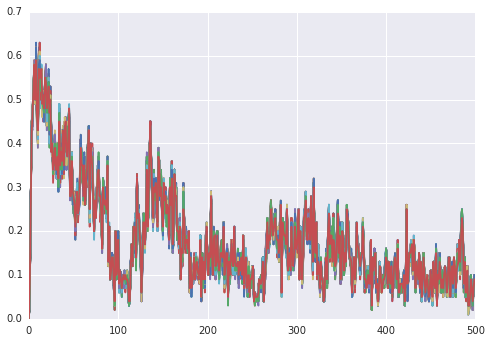

In [29]:
for dim in range(105):
    plt.plot(range(500), running_acceptance_rates_100window[dim, :])

In [31]:
acceptance_rates = np.zeros((len(traces['b'][0][0],)))
vector_acceptance_rate = 0
running_acceptance_rates = np.zeros((len(traces['b'][0][0]), len(traces['b'][0])))
running_acceptance_rates_100window = np.zeros((len(traces['b'][0][0]), 500))
n_vector_acceptances = 0
n_100windowvec_acceptances = 0
running_acceptance_rates_vec = np.zeros((1, len(traces['b'][0])))
running_acceptances_rates_vec_100window = np.zeros((1, 500))
for dim in range(len(traces['b'][0][0])):
    n_100window_acceptances = 0
    n_acceptances = 0
    
    for iteration in range(1, len(traces['b'][0])):
        if dim == 0:
            comparison = traces['b'][0][iteration] == traces['b'][0][iteration-1]
            if not np.all(comparison):
                n_vector_acceptances += 1
                n_100windowvec_acceptances += 1
            running_acceptance_rates_vec[0, iteration] = float(n_vector_acceptances)/iteration
            if iteration % 100 == 0:
                running_acceptances_rates_vec_100window[0, iteration/100] = float(n_100windowvec_acceptances)/100
                n_100windowvec_acceptances = 0
        if traces['b'][0][iteration][dim] != traces['b'][0][iteration-1][dim]:
            n_acceptances += 1
            n_100window_acceptances += 1
        running_acceptance_rates[dim, iteration] = float(n_acceptances)/iteration
        
        if iteration % 100 == 0:
            running_acceptance_rates_100window[dim, iteration/100] = float(n_100window_acceptances)/100
            n_100window_acceptances = 0
            
    acceptance_rates[dim] = float(n_acceptances)/len(traces['b'][0])
    print 'N acceptances for parameter: ',str(param_trace_dict_a['param_list'][dim]),' = ',str(n_acceptances),' acceptance rate: ',str(acceptance_rates[dim])
    n_acceptances = 0
print 'n vector acceptances: ',n_vector_acceptances
print 'Acceptance rate for vector: ',float(n_vector_acceptances)/len(traces['b'][0])
running_acceptance_rates
running_acceptance_rates_100window
running_acceptance_rates_vec
running_acceptances_rates_vec_100window

 N acceptances for parameter:  bind_L_R_to_LR_kf  =  5614  acceptance rate:  0.11228
N acceptances for parameter:  bind_L_R_to_LR_kr  =  6102  acceptance rate:  0.12204
N acceptances for parameter:  convert_LR_to_DISC_kc  =  5763  acceptance rate:  0.11526
N acceptances for parameter:  bind_DISC_C8pro_to_DISCC8pro_kf  =  5875  acceptance rate:  0.1175
N acceptances for parameter:  bind_DISC_C8pro_to_DISCC8pro_kr  =  6087  acceptance rate:  0.12174
N acceptances for parameter:  catalyze_DISCC8pro_to_DISC_C8A_kc  =  5863  acceptance rate:  0.11726
N acceptances for parameter:  bind_C8A_BidU_to_C8ABidU_kf  =  5967  acceptance rate:  0.11934
N acceptances for parameter:  bind_C8A_BidU_to_C8ABidU_kr  =  6124  acceptance rate:  0.12248
N acceptances for parameter:  catalyze_C8ABidU_to_C8A_BidT_kc  =  5819  acceptance rate:  0.11638
N acceptances for parameter:  bind_DISC_flip_kf  =  6129  acceptance rate:  0.12258
N acceptances for parameter:  bind_DISC_flip_kr  =  6133  acceptance rate:  0.

array([[ 0.  ,  0.15,  0.28,  0.29,  0.43,  0.48,  0.44,  0.45,  0.49,
         0.55,  0.52,  0.56,  0.52,  0.46,  0.44,  0.45,  0.53,  0.43,
         0.43,  0.46,  0.47,  0.4 ,  0.46,  0.4 ,  0.41,  0.4 ,  0.52,
         0.51,  0.44,  0.43,  0.48,  0.44,  0.42,  0.38,  0.4 ,  0.31,
         0.36,  0.22,  0.38,  0.29,  0.38,  0.42,  0.42,  0.35,  0.28,
         0.26,  0.36,  0.15,  0.34,  0.33,  0.35,  0.44,  0.46,  0.41,
         0.31,  0.32,  0.37,  0.31,  0.38,  0.32,  0.28,  0.36,  0.21,
         0.33,  0.35,  0.46,  0.3 ,  0.34,  0.3 ,  0.17,  0.27,  0.32,
         0.34,  0.22,  0.43,  0.42,  0.39,  0.28,  0.29,  0.28,  0.36,
         0.16,  0.26,  0.2 ,  0.24,  0.28,  0.26,  0.25,  0.23,  0.3 ,
         0.26,  0.26,  0.28,  0.25,  0.33,  0.18,  0.25,  0.29,  0.23,
         0.17,  0.21,  0.18,  0.22,  0.2 ,  0.22,  0.15,  0.14,  0.12,
         0.15,  0.13,  0.17,  0.25,  0.2 ,  0.1 ,  0.12,  0.09,  0.14,
         0.28,  0.2 ,  0.17,  0.12,  0.05,  0.13,  0.2 ,  0.17,  0.13,
      

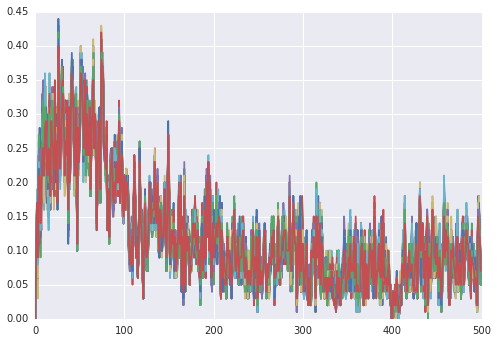

In [32]:
for dim in range(105):
    plt.plot(range(500), running_acceptance_rates_100window[dim, :])

In [33]:
acceptance_rates = np.zeros((len(traces['c'][0][0],)))
vector_acceptance_rate = 0
running_acceptance_rates = np.zeros((len(traces['c'][0][0]), len(traces['c'][0])))
running_acceptance_rates_100window = np.zeros((len(traces['c'][0][0]), 500))
n_vector_acceptances = 0
n_100windowvec_acceptances = 0
running_acceptance_rates_vec = np.zeros((1, len(traces['c'][0])))
running_acceptances_rates_vec_100window = np.zeros((1, 500))
for dim in range(len(traces['c'][0][0])):
    n_100window_acceptances = 0
    n_acceptances = 0
    
    for iteration in range(1, len(traces['c'][0])):
        if dim == 0:
            comparison = traces['c'][0][iteration] == traces['c'][0][iteration-1]
            if not np.all(comparison):
                n_vector_acceptances += 1
                n_100windowvec_acceptances += 1
            running_acceptance_rates_vec[0, iteration] = float(n_vector_acceptances)/iteration
            if iteration % 100 == 0:
                running_acceptances_rates_vec_100window[0, iteration/100] = float(n_100windowvec_acceptances)/100
                n_100windowvec_acceptances = 0
        if traces['c'][0][iteration][dim] != traces['c'][0][iteration-1][dim]:
            n_acceptances += 1
            n_100window_acceptances += 1
        running_acceptance_rates[dim, iteration] = float(n_acceptances)/iteration
        
        if iteration % 100 == 0:
            running_acceptance_rates_100window[dim, iteration/100] = float(n_100window_acceptances)/100
            n_100window_acceptances = 0
            
    acceptance_rates[dim] = float(n_acceptances)/len(traces['c'][0])
    print 'N acceptances for parameter: ',str(param_trace_dict_a['param_list'][dim]),' = ',str(n_acceptances),' acceptance rate: ',str(acceptance_rates[dim])
    n_acceptances = 0
print 'n vector acceptances: ',n_vector_acceptances
print 'Acceptance rate for vector: ',float(n_vector_acceptances)/len(traces['c'][0])
running_acceptance_rates
running_acceptance_rates_100window
running_acceptance_rates_vec
running_acceptances_rates_vec_100window

N acceptances for parameter:  bind_L_R_to_LR_kf  =  6025  acceptance rate:  0.1205
N acceptances for parameter:  bind_L_R_to_LR_kr  =  5946  acceptance rate:  0.11892
N acceptances for parameter:  convert_LR_to_DISC_kc  =  5993  acceptance rate:  0.11986
N acceptances for parameter:  bind_DISC_C8pro_to_DISCC8pro_kf  =  5932  acceptance rate:  0.11864
N acceptances for parameter:  bind_DISC_C8pro_to_DISCC8pro_kr  =  6112  acceptance rate:  0.12224
N acceptances for parameter:  catalyze_DISCC8pro_to_DISC_C8A_kc  =  5969  acceptance rate:  0.11938
N acceptances for parameter:  bind_C8A_BidU_to_C8ABidU_kf  =  5980  acceptance rate:  0.1196
N acceptances for parameter:  bind_C8A_BidU_to_C8ABidU_kr  =  6038  acceptance rate:  0.12076
N acceptances for parameter:  catalyze_C8ABidU_to_C8A_BidT_kc  =  5897  acceptance rate:  0.11794
N acceptances for parameter:  bind_DISC_flip_kf  =  6050  acceptance rate:  0.121
N acceptances for parameter:  bind_DISC_flip_kr  =  6048  acceptance rate:  0.1209

array([[ 0.  ,  0.04,  0.25,  0.29,  0.43,  0.43,  0.42,  0.48,  0.49,
         0.48,  0.46,  0.5 ,  0.54,  0.59,  0.51,  0.6 ,  0.55,  0.44,
         0.41,  0.43,  0.43,  0.4 ,  0.37,  0.34,  0.35,  0.33,  0.33,
         0.22,  0.18,  0.37,  0.25,  0.18,  0.25,  0.29,  0.34,  0.21,
         0.26,  0.27,  0.36,  0.28,  0.26,  0.24,  0.2 ,  0.32,  0.33,
         0.35,  0.28,  0.29,  0.31,  0.26,  0.21,  0.12,  0.25,  0.23,
         0.14,  0.18,  0.15,  0.17,  0.25,  0.21,  0.21,  0.22,  0.14,
         0.17,  0.22,  0.19,  0.19,  0.15,  0.09,  0.16,  0.07,  0.12,
         0.08,  0.15,  0.21,  0.2 ,  0.15,  0.23,  0.19,  0.26,  0.2 ,
         0.15,  0.16,  0.33,  0.25,  0.23,  0.22,  0.18,  0.24,  0.14,
         0.19,  0.15,  0.23,  0.21,  0.15,  0.19,  0.17,  0.2 ,  0.21,
         0.24,  0.16,  0.27,  0.18,  0.18,  0.2 ,  0.14,  0.13,  0.21,
         0.23,  0.17,  0.17,  0.21,  0.23,  0.22,  0.21,  0.23,  0.32,
         0.24,  0.19,  0.33,  0.21,  0.21,  0.21,  0.3 ,  0.22,  0.25,
      

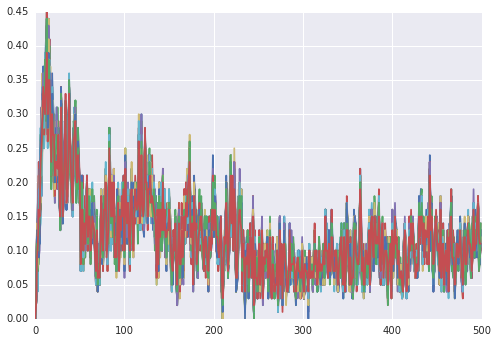

In [34]:
for dim in range(105):
    plt.plot(range(500), running_acceptance_rates_100window[dim, :])

In [35]:
acceptance_rates = np.zeros((len(traces['d'][0][0],)))
vector_acceptance_rate = 0
running_acceptance_rates = np.zeros((len(traces['d'][0][0]), len(traces['d'][0])))
running_acceptance_rates_100window = np.zeros((len(traces['d'][0][0]), 500))
n_vector_acceptances = 0
n_100windowvec_acceptances = 0
running_acceptance_rates_vec = np.zeros((1, len(traces['d'][0])))
running_acceptances_rates_vec_100window = np.zeros((1, 500))
for dim in range(len(traces['d'][0][0])):
    n_100window_acceptances = 0
    n_acceptances = 0
    
    for iteration in range(1, len(traces['d'][0])):
        if dim == 0:
            comparison = traces['d'][0][iteration] == traces['d'][0][iteration-1]
            if not np.all(comparison):
                n_vector_acceptances += 1
                n_100windowvec_acceptances += 1
            running_acceptance_rates_vec[0, iteration] = float(n_vector_acceptances)/iteration
            if iteration % 100 == 0:
                running_acceptances_rates_vec_100window[0, iteration/100] = float(n_100windowvec_acceptances)/100
                n_100windowvec_acceptances = 0
        if traces['d'][0][iteration][dim] != traces['d'][0][iteration-1][dim]:
            n_acceptances += 1
            n_100window_acceptances += 1
        running_acceptance_rates[dim, iteration] = float(n_acceptances)/iteration
        
        if iteration % 100 == 0:
            running_acceptance_rates_100window[dim, iteration/100] = float(n_100window_acceptances)/100
            n_100window_acceptances = 0
            
    acceptance_rates[dim] = float(n_acceptances)/len(traces['d'][0])
    print 'N acceptances for parameter: ',str(param_trace_dict_a['param_list'][dim]),' = ',str(n_acceptances),' acceptance rate: ',str(acceptance_rates[dim])
    n_acceptances = 0
print 'n vector acceptances: ',n_vector_acceptances
print 'Acceptance rate for vector: ',float(n_vector_acceptances)/len(traces['d'][0])
running_acceptance_rates
running_acceptance_rates_100window
running_acceptance_rates_vec
running_acceptances_rates_vec_100window

N acceptances for parameter:  bind_L_R_to_LR_kf  =  3825  acceptance rate:  0.0765
N acceptances for parameter:  bind_L_R_to_LR_kr  =  4397  acceptance rate:  0.08794
N acceptances for parameter:  convert_LR_to_DISC_kc  =  4126  acceptance rate:  0.08252
N acceptances for parameter:  bind_DISC_C8pro_to_DISCC8pro_kf  =  4183  acceptance rate:  0.08366
N acceptances for parameter:  bind_DISC_C8pro_to_DISCC8pro_kr  =  4301  acceptance rate:  0.08602
N acceptances for parameter:  catalyze_DISCC8pro_to_DISC_C8A_kc  =  4085  acceptance rate:  0.0817
N acceptances for parameter:  bind_C8A_BidU_to_C8ABidU_kf  =  4368  acceptance rate:  0.08736
N acceptances for parameter:  bind_C8A_BidU_to_C8ABidU_kr  =  4387  acceptance rate:  0.08774
N acceptances for parameter:  catalyze_C8ABidU_to_C8A_BidT_kc  =  4029  acceptance rate:  0.08058
N acceptances for parameter:  bind_DISC_flip_kf  =  4321  acceptance rate:  0.08642
N acceptances for parameter:  bind_DISC_flip_kr  =  4332  acceptance rate:  0.08

array([[ 0.  ,  0.1 ,  0.22,  0.33,  0.38,  0.39,  0.43,  0.45,  0.4 ,
         0.37,  0.44,  0.44,  0.47,  0.41,  0.4 ,  0.35,  0.38,  0.34,
         0.38,  0.2 ,  0.37,  0.36,  0.33,  0.41,  0.34,  0.28,  0.34,
         0.25,  0.35,  0.34,  0.44,  0.33,  0.34,  0.31,  0.3 ,  0.29,
         0.34,  0.31,  0.33,  0.3 ,  0.26,  0.27,  0.36,  0.34,  0.34,
         0.22,  0.36,  0.26,  0.33,  0.23,  0.36,  0.26,  0.22,  0.21,
         0.25,  0.27,  0.27,  0.26,  0.19,  0.31,  0.26,  0.27,  0.27,
         0.14,  0.21,  0.28,  0.16,  0.23,  0.36,  0.22,  0.32,  0.33,
         0.35,  0.29,  0.33,  0.24,  0.26,  0.19,  0.2 ,  0.23,  0.25,
         0.22,  0.24,  0.15,  0.3 ,  0.21,  0.26,  0.16,  0.14,  0.23,
         0.21,  0.19,  0.12,  0.14,  0.1 ,  0.16,  0.15,  0.19,  0.15,
         0.11,  0.18,  0.17,  0.13,  0.05,  0.2 ,  0.15,  0.17,  0.18,
         0.16,  0.2 ,  0.14,  0.03,  0.13,  0.13,  0.05,  0.21,  0.12,
         0.06,  0.07,  0.06,  0.15,  0.15,  0.08,  0.04,  0.11,  0.07,
      

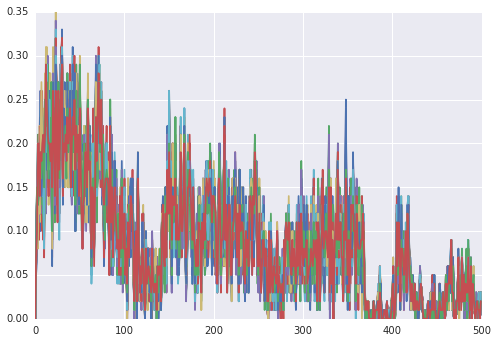

In [36]:
for dim in range(105):
    plt.plot(range(500), running_acceptance_rates_100window[dim, :])